<a href="https://www.kaggle.com/code/ahmednasser1601/semantic-segmentation?scriptVersionId=158229021" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
import numpy as np
from glob import glob
from tqdm import tqdm
import matplotlib.pyplot as plt
import tensorflow as tf
from keras.utils import load_img, img_to_array, plot_model, to_categorical
from keras import models, optimizers, callbacks
from keras.layers import Input, Layer, Conv2D, Dropout, MaxPool2D, Concatenate, Conv2DTranspose, BatchNormalization

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
dataset_path = '/kaggle/input/semantic-segmentation/'

all_images = glob(dataset_path + "*.jpg")
all_paths = [path.replace(".jpg",".jpg___fuse.png") for path in all_images]

In [3]:
images = np.zeros(shape=(len(all_images), 256, 256, 3))
masks = np.zeros(shape=(len(all_paths), 256, 256, 3))

for x, (i, m) in tqdm(enumerate(zip(all_images, all_paths)), desc="Loading Files.."):
    image = tf.image.resize(load_img(i), (256, 256))
    mask = tf.image.resize(load_img(m), (256, 256))
    images[x] = tf.cast(img_to_array(image), tf.float32) / 255.
    masks[x] = tf.cast(img_to_array(mask), tf.float32) / 255.

masks_encoded = to_categorical(np.argmax(masks, axis=-1), num_classes=11)

Loading Files..: 100it [00:07, 13.19it/s]


## U-Net Model

In [4]:
class Encoder(Layer):
    def __init__(self, filters, rate=0.2, pooling=True, **kwargs):
        super(Encoder, self).__init__(**kwargs)
        
        self.filters = filters
        self.rate = rate
        self.pooling = pooling
        self.c1 = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.c2 = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.bn = BatchNormalization()
        self.pool = MaxPool2D()
        self.drop = Dropout(rate)
    
    def call(self, X):
        x = self.c2(self.drop(self.c1(self.bn(X))))
        if self.pooling:
            return x, self.pool(x)
        return x
    
    def get_config(self):
        base_config = super().get_config()
        return {**base_config, "filters":self.filters, "rate":self.rate,"pooling":self.pooling}

In [5]:
class Decoder(Layer):
    def __init__(self, filters, rate, **kwargs):
        super(Decoder, self).__init__(**kwargs)
        
        self.filters = filters
        self.rate = rate
        self.cT = Conv2DTranspose(filters, kernel_size=3, strides=2, padding='same', activation='relu', kernel_initializer='he_normal')
        self.net = Encoder(filters, rate, pooling=False)
        self.bn = BatchNormalization()
        self.skip = Concatenate()
    
    def call(self, X):
        y = self.cT(self.bn(X[0]))
        return self.net(self.skip([y, X[1]]))
    
    def get_config(self):
        base_config = super().get_config()
        return {**base_config, "filters":self.filters, "rate":self.rate}

In [6]:
# Input
InputL = Input(shape=(256, 256, 3), name="InputImage")

# Encoder Block 
c1, p1 = Encoder(filters=64,  rate=0.1, name="Encoder1")(InputL)
c2, p2 = Encoder(filters=128, rate=0.1, name="Encoder2")(p1)
c3, p3 = Encoder(filters=256, rate=0.2, name="Encoder3")(p2)
c4, p4 = Encoder(filters=512, rate=0.2, name="Encoder4")(p3)

# Encoding Layer
encodings = Encoder(filters=512, rate=0.3, pooling=False, name="Encoding")(p4)

# Decoder Block
d = Decoder(512, 0.2, name='Decoder1')([encodings, c4])
d = Decoder(256, 0.2, name='Decoder2')([d, c3])
d = Decoder(128, 0.1, name='Decoder3')([d, c2])
d = Decoder(64, 0.1, name='Decoder4')([d, c1])

# Output
conv_out = Conv2D(11, kernel_size=3, padding='same', activation='softmax', name="Segmentator")(d)

In [7]:
model = models.Model(InputL, conv_out, name="U-Net")
model.summary()

Model: "U-Net"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 InputImage (InputLayer)     [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 Encoder1 (Encoder)          ((None, 256, 256, 64),       38732     ['InputImage[0][0]']          
                              (None, 128, 128, 64))                                               
                                                                                                  
 Encoder2 (Encoder)          ((None, 128, 128, 128),      221696    ['Encoder1[0][1]']            
                              (None, 64, 64, 128))                                                
                                                                                              

In [8]:
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

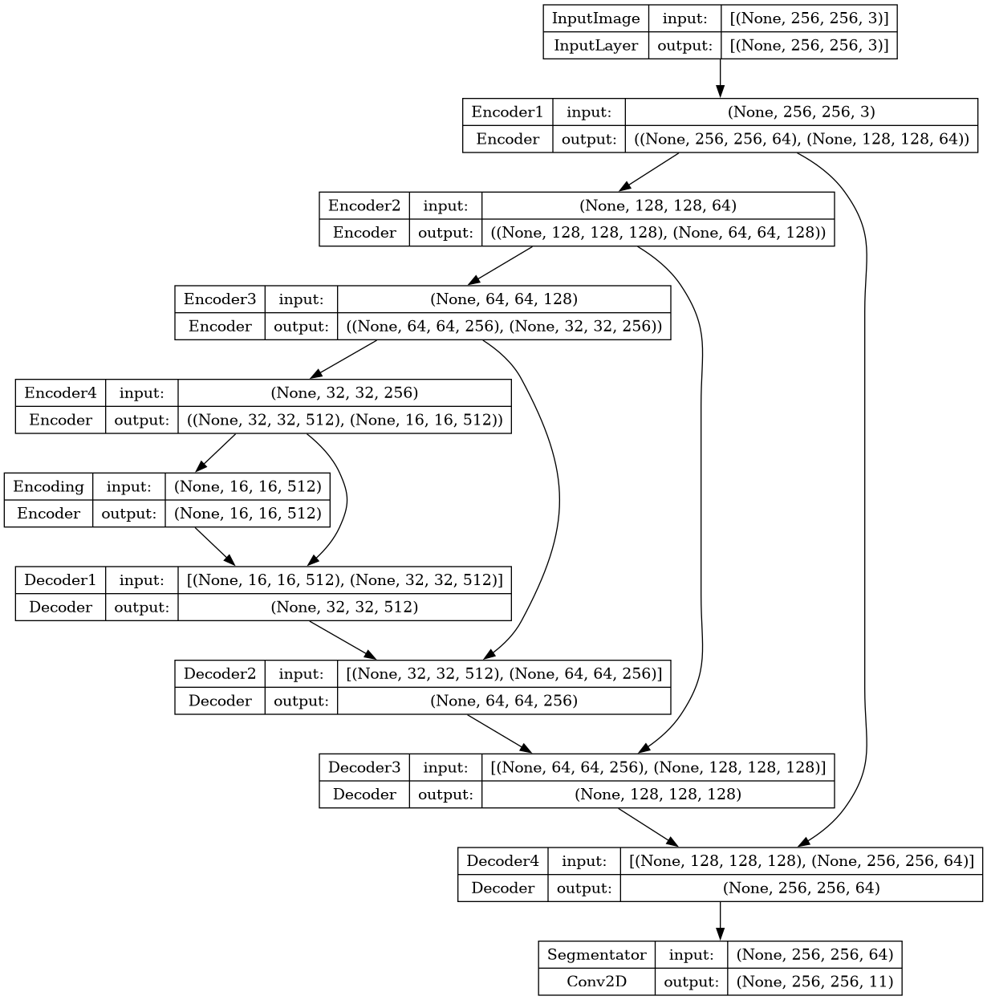

In [9]:
plot_model(model, "U-Net.png", show_shapes=True)

In [10]:
class ShowProgress(callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        i = np.random.randint(len(images))
        plt.figure(figsize=(8, 5))

        plt.subplot(1, 3, 1)
        plt.imshow(images[i])
        plt.title("Original")
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(np.argmax(masks_encoded[i], axis=-1), cmap='viridis')
        plt.title("Mask")
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow((np.argmax(self.model.predict(np.expand_dims(images[i], axis=0)), axis=-1))[0], cmap='viridis')
        plt.title("Predicted")
        plt.axis('off')

        plt.tight_layout()
        plt.show()

Epoch 1/100


2024-01-08 23:43:15.466177: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inU-Net/Encoder1/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


1/1 [==============================] - 1s 991ms/step


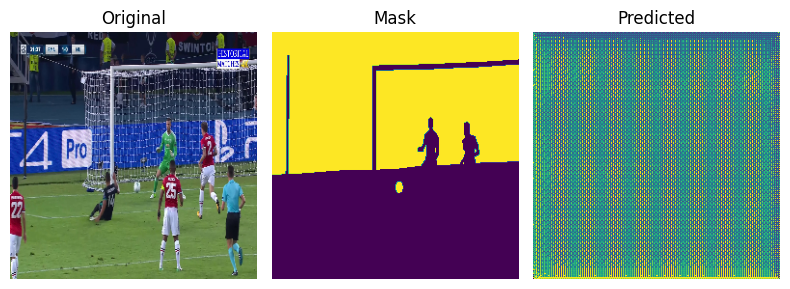

10/10 [==============================] - 26s 544ms/step - loss: 2.6274 - accuracy: 0.5914
Epoch 2/100
1/1 [==============================] - 0s 22ms/step


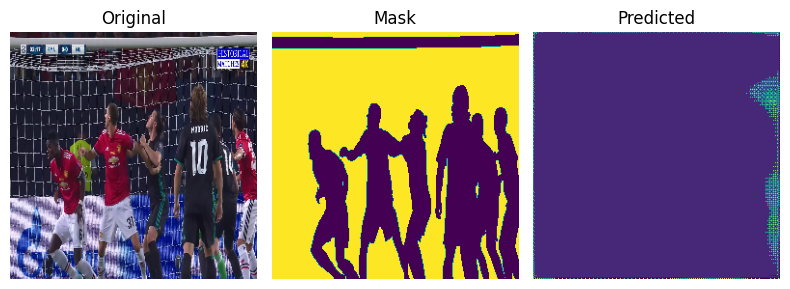

10/10 [==============================] - 4s 429ms/step - loss: 3.7163 - accuracy: 0.6066
Epoch 3/100
1/1 [==============================] - 0s 20ms/step


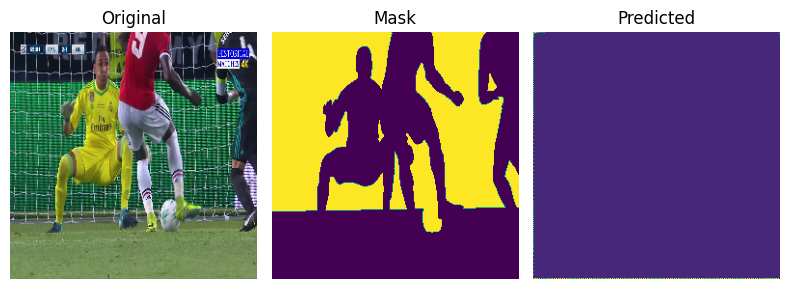

10/10 [==============================] - 4s 429ms/step - loss: 10.0323 - accuracy: 0.5357
Epoch 4/100
1/1 [==============================] - 0s 21ms/step


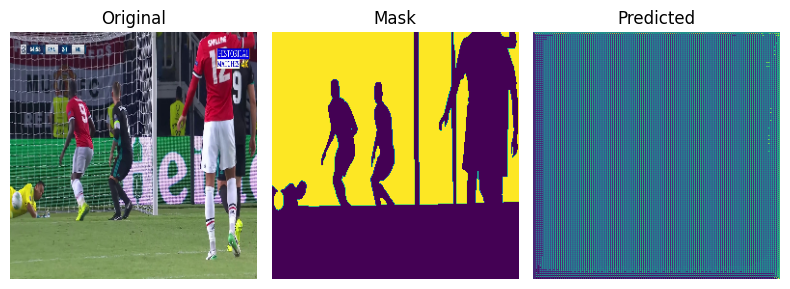

10/10 [==============================] - 4s 421ms/step - loss: 21.3166 - accuracy: 0.4800
Epoch 5/100
1/1 [==============================] - 0s 20ms/step


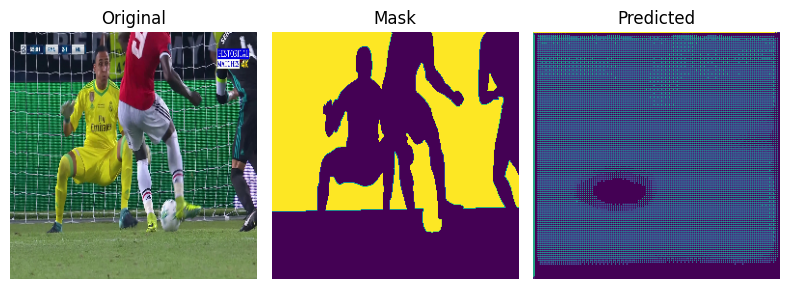

10/10 [==============================] - 4s 428ms/step - loss: 39.3326 - accuracy: 0.5312
Epoch 6/100
1/1 [==============================] - 0s 21ms/step


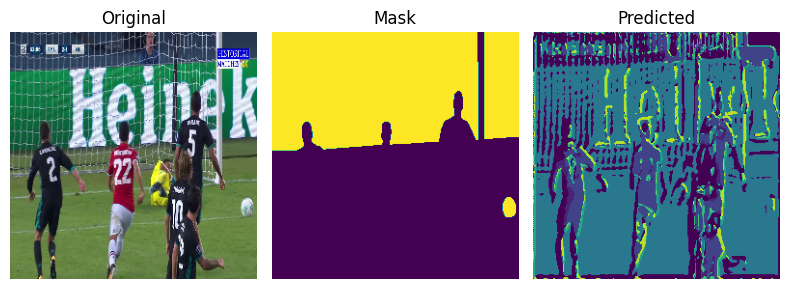

10/10 [==============================] - 4s 428ms/step - loss: 56.7939 - accuracy: 0.5172
Epoch 7/100
1/1 [==============================] - 0s 20ms/step


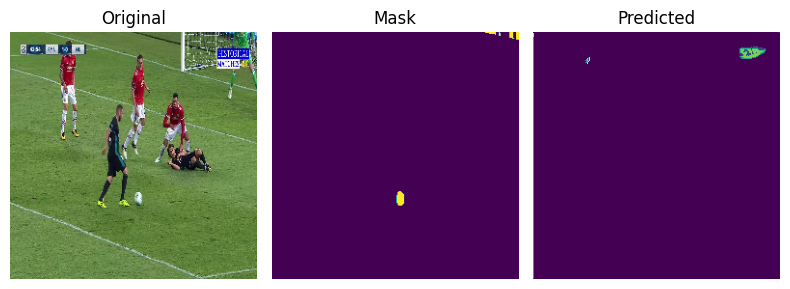

10/10 [==============================] - 4s 426ms/step - loss: 116.9341 - accuracy: 0.5414
Epoch 8/100
1/1 [==============================] - 0s 21ms/step


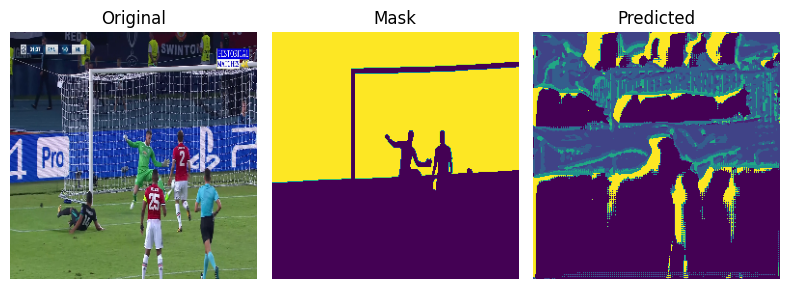

10/10 [==============================] - 4s 453ms/step - loss: 230.9584 - accuracy: 0.5744
Epoch 9/100
1/1 [==============================] - 0s 22ms/step


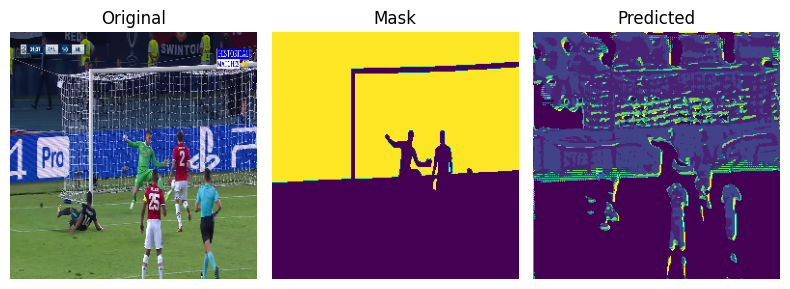

10/10 [==============================] - 4s 430ms/step - loss: 260.1149 - accuracy: 0.5507
Epoch 10/100
1/1 [==============================] - 0s 22ms/step


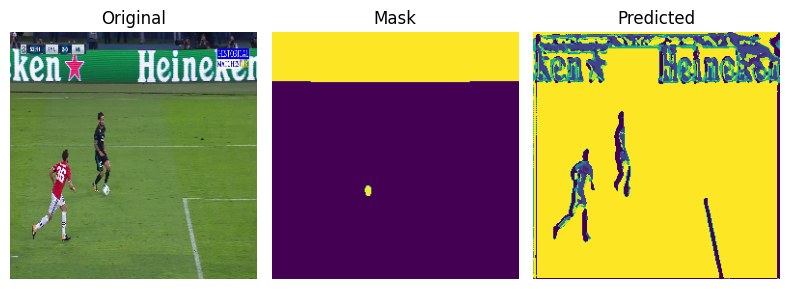

10/10 [==============================] - 4s 426ms/step - loss: 387.0625 - accuracy: 0.5240
Epoch 11/100
1/1 [==============================] - 0s 21ms/step


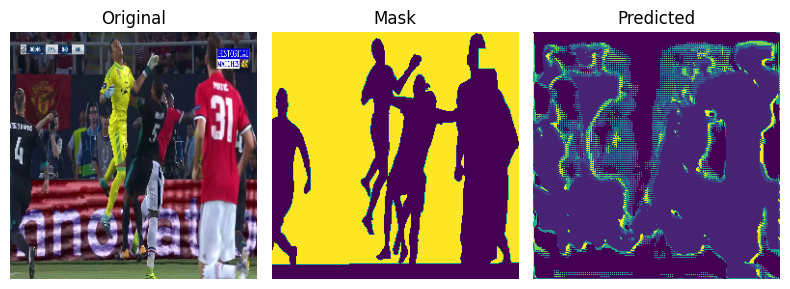

10/10 [==============================] - 4s 421ms/step - loss: 489.5602 - accuracy: 0.5388
Epoch 12/100
1/1 [==============================] - 0s 21ms/step


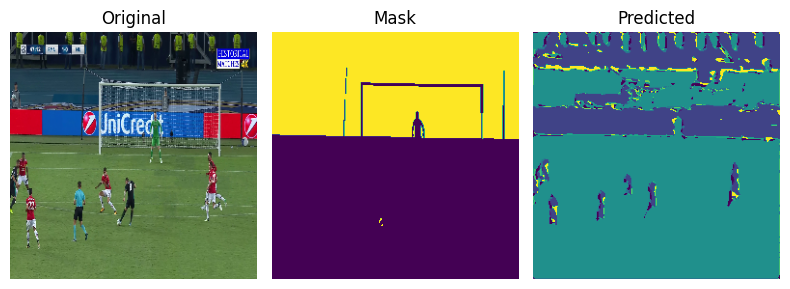

10/10 [==============================] - 4s 429ms/step - loss: 584.4656 - accuracy: 0.5157
Epoch 13/100
1/1 [==============================] - 0s 22ms/step


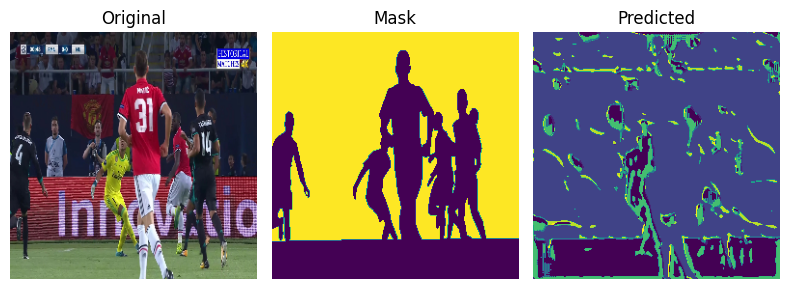

10/10 [==============================] - 4s 418ms/step - loss: 854.0813 - accuracy: 0.4819
Epoch 14/100
1/1 [==============================] - 0s 22ms/step


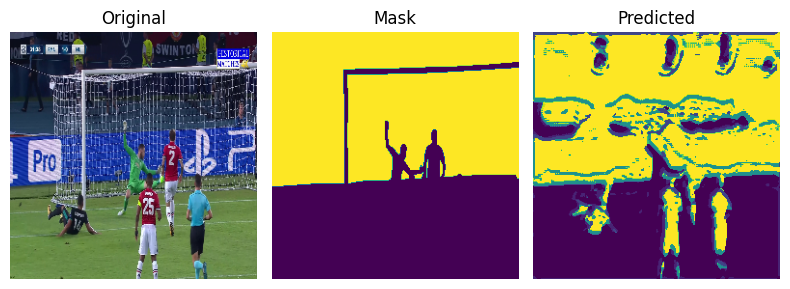

10/10 [==============================] - 4s 429ms/step - loss: 1166.0511 - accuracy: 0.5563
Epoch 15/100
1/1 [==============================] - 0s 31ms/step


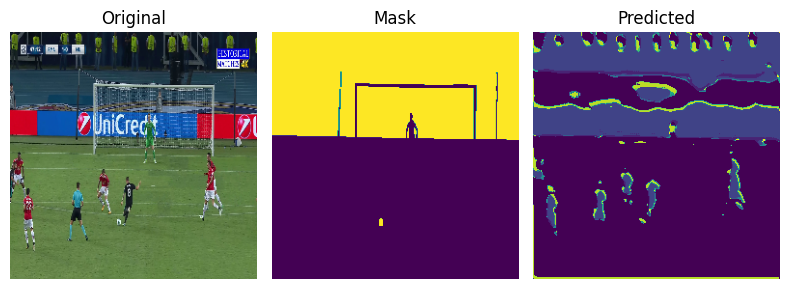

10/10 [==============================] - 4s 429ms/step - loss: 1311.6736 - accuracy: 0.4863
Epoch 16/100
1/1 [==============================] - 0s 20ms/step


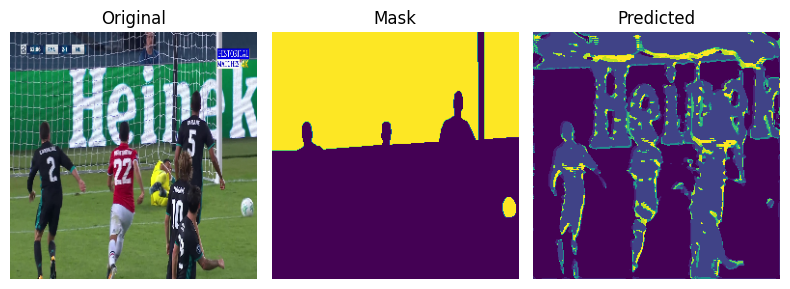

10/10 [==============================] - 4s 427ms/step - loss: 1409.2081 - accuracy: 0.5155
Epoch 17/100
1/1 [==============================] - 0s 21ms/step


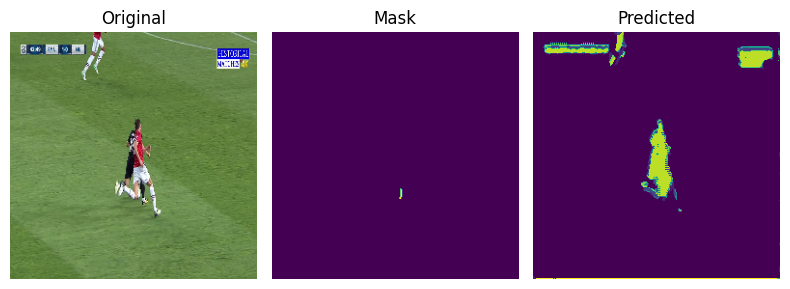

10/10 [==============================] - 4s 418ms/step - loss: 1632.2993 - accuracy: 0.5397
Epoch 18/100
1/1 [==============================] - 0s 21ms/step


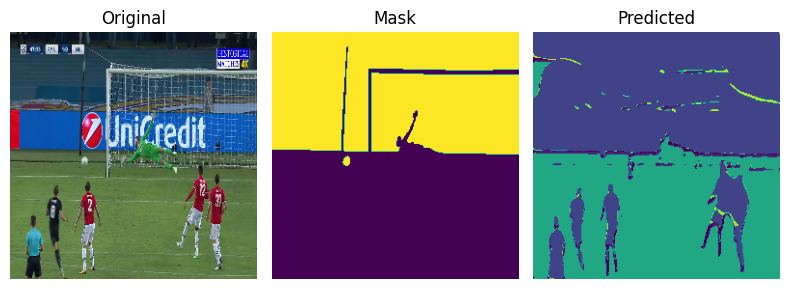

10/10 [==============================] - 4s 428ms/step - loss: 1879.2429 - accuracy: 0.3903
Epoch 19/100
1/1 [==============================] - 0s 22ms/step


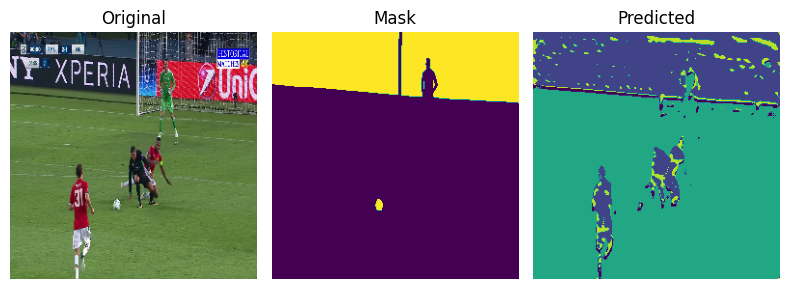

10/10 [==============================] - 4s 429ms/step - loss: 3933.4629 - accuracy: 0.6117
Epoch 20/100
1/1 [==============================] - 0s 22ms/step


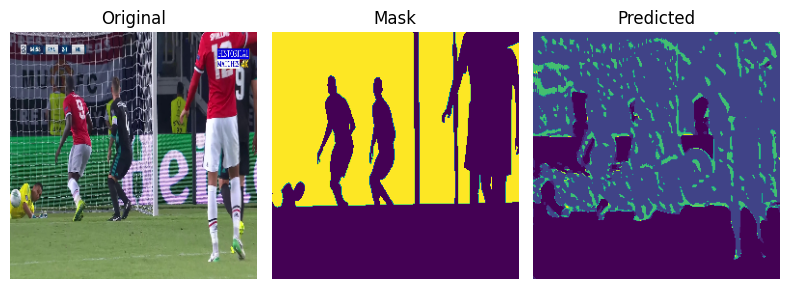

10/10 [==============================] - 4s 419ms/step - loss: 4219.6938 - accuracy: 0.3498
Epoch 21/100
1/1 [==============================] - 0s 21ms/step


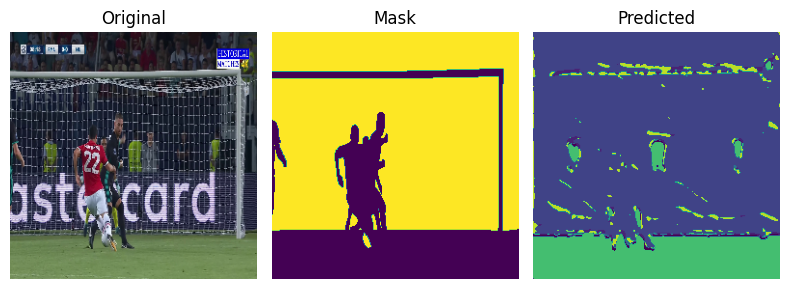

10/10 [==============================] - 4s 428ms/step - loss: 6606.6362 - accuracy: 0.4912
Epoch 22/100
1/1 [==============================] - 0s 20ms/step


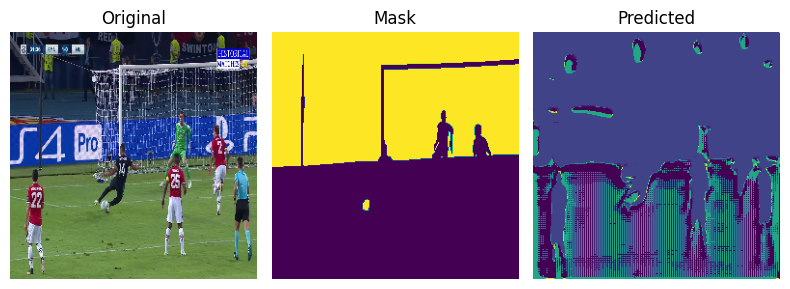

10/10 [==============================] - 4s 426ms/step - loss: 5114.7788 - accuracy: 0.4967
Epoch 23/100
1/1 [==============================] - 0s 20ms/step


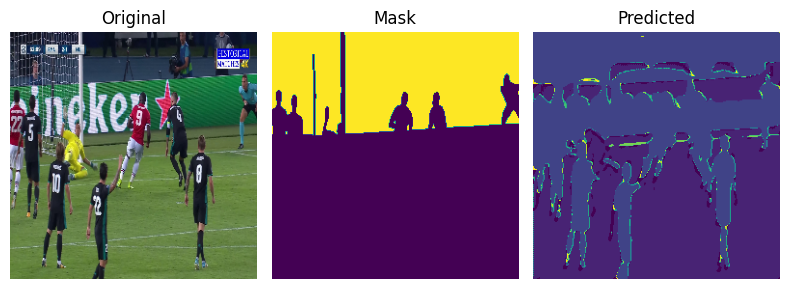

10/10 [==============================] - 4s 429ms/step - loss: 4336.1606 - accuracy: 0.4120
Epoch 24/100
1/1 [==============================] - 0s 20ms/step


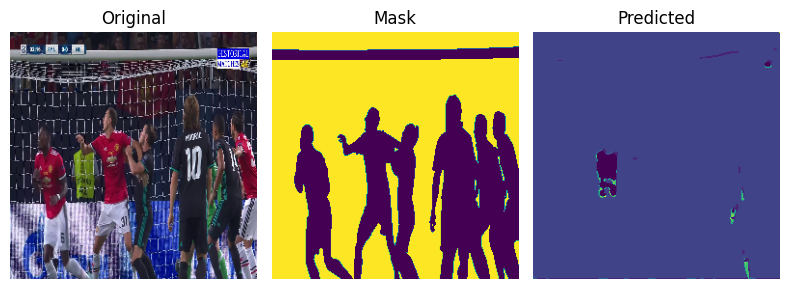

10/10 [==============================] - 4s 421ms/step - loss: 6019.0396 - accuracy: 0.4305
Epoch 25/100
1/1 [==============================] - 0s 21ms/step


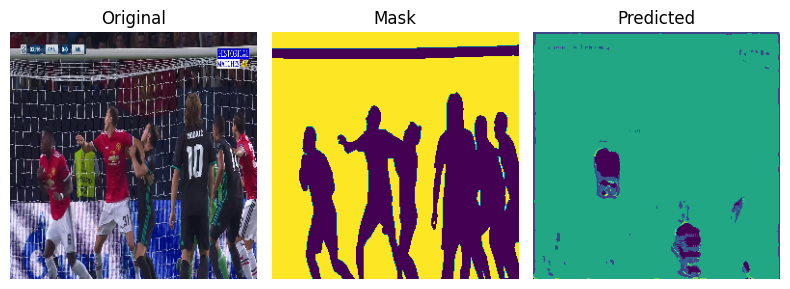

10/10 [==============================] - 5s 459ms/step - loss: 5449.5493 - accuracy: 0.4258
Epoch 26/100
1/1 [==============================] - 0s 21ms/step


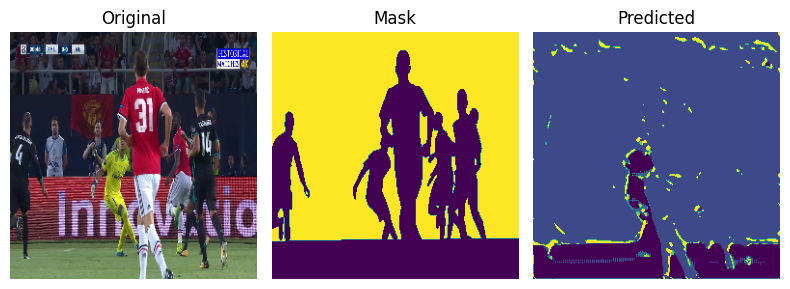

10/10 [==============================] - 4s 430ms/step - loss: 7123.2441 - accuracy: 0.4111
Epoch 27/100
1/1 [==============================] - 0s 22ms/step


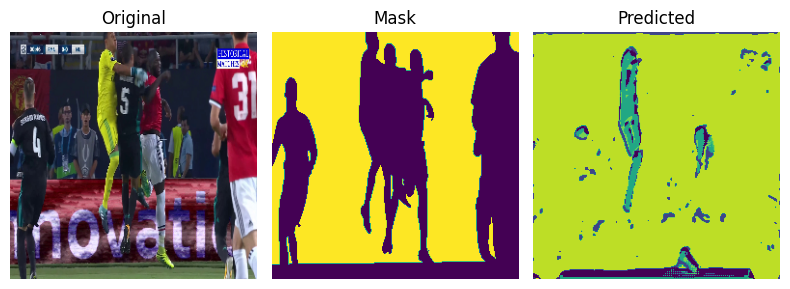

10/10 [==============================] - 4s 420ms/step - loss: 7177.0713 - accuracy: 0.4588
Epoch 28/100
1/1 [==============================] - 0s 23ms/step


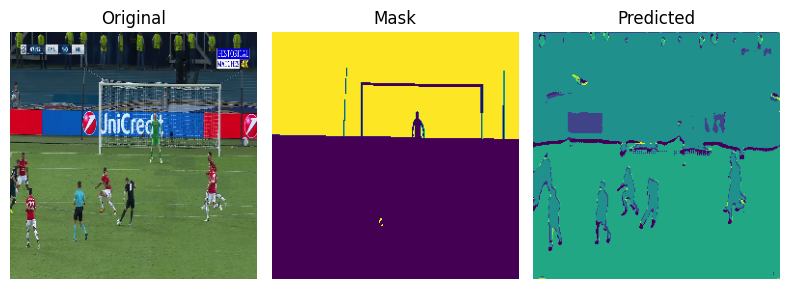

10/10 [==============================] - 4s 421ms/step - loss: 6280.9424 - accuracy: 0.4330
Epoch 29/100
1/1 [==============================] - 0s 22ms/step


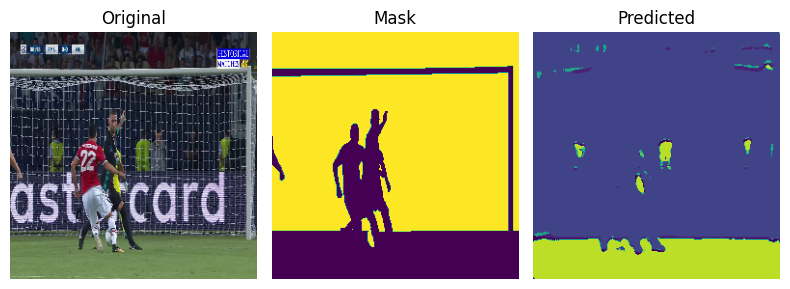

10/10 [==============================] - 4s 421ms/step - loss: 8138.3574 - accuracy: 0.4114
Epoch 30/100
1/1 [==============================] - 0s 21ms/step


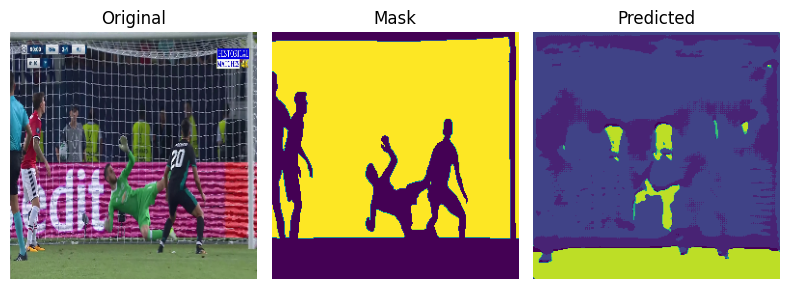

10/10 [==============================] - 4s 419ms/step - loss: 8525.9072 - accuracy: 0.4279
Epoch 31/100
1/1 [==============================] - 0s 21ms/step


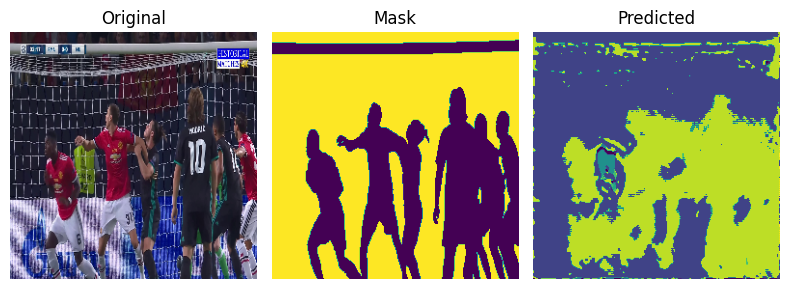

10/10 [==============================] - 4s 421ms/step - loss: 8430.6914 - accuracy: 0.4429
Epoch 32/100
1/1 [==============================] - 0s 21ms/step


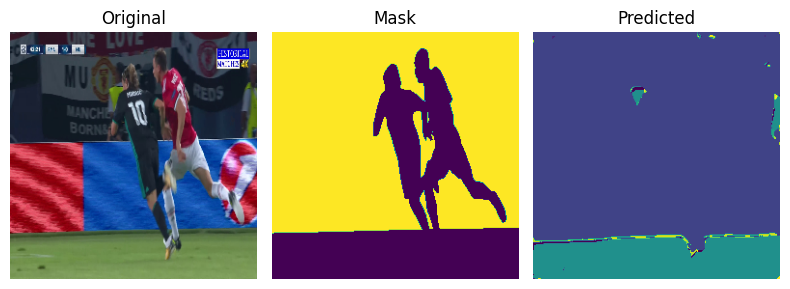

10/10 [==============================] - 4s 428ms/step - loss: 10609.7451 - accuracy: 0.4782
Epoch 33/100
1/1 [==============================] - 0s 22ms/step


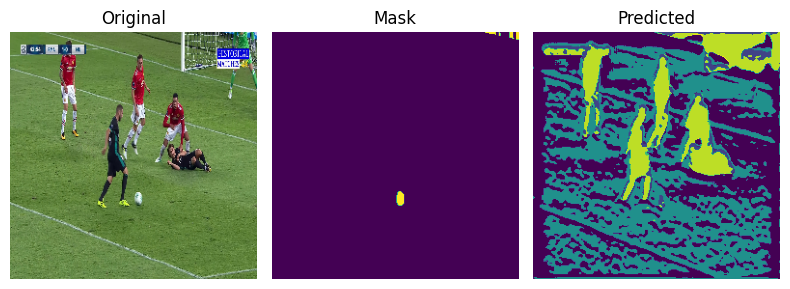

10/10 [==============================] - 4s 429ms/step - loss: 13508.8164 - accuracy: 0.4019
Epoch 34/100
1/1 [==============================] - 0s 22ms/step


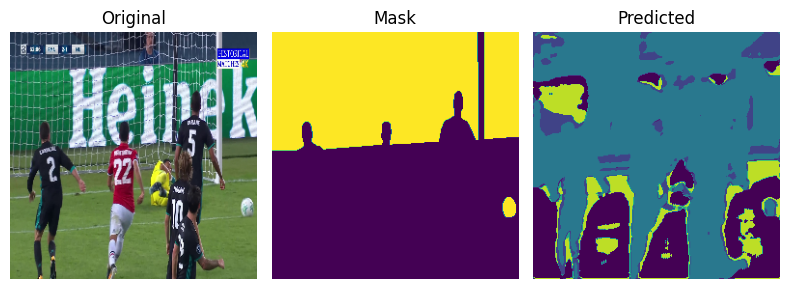

10/10 [==============================] - 4s 428ms/step - loss: 14717.3301 - accuracy: 0.4222
Epoch 35/100
1/1 [==============================] - 0s 21ms/step


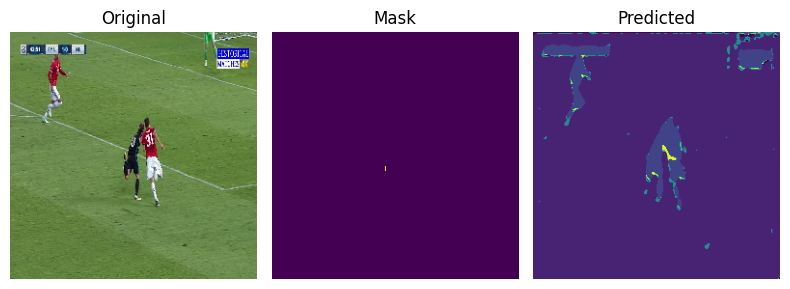

10/10 [==============================] - 4s 417ms/step - loss: 14912.7578 - accuracy: 0.4177
Epoch 36/100
1/1 [==============================] - 0s 20ms/step


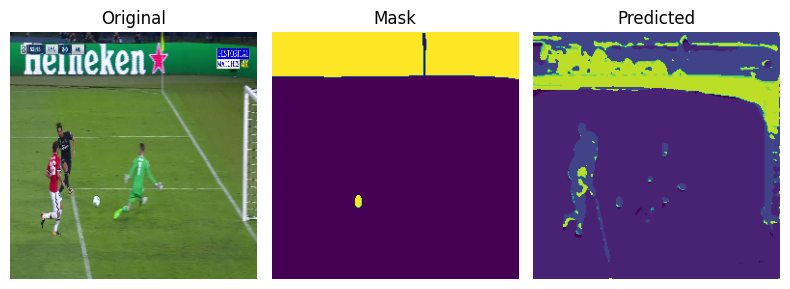

10/10 [==============================] - 4s 427ms/step - loss: 19838.3730 - accuracy: 0.4476
Epoch 37/100
1/1 [==============================] - 0s 21ms/step


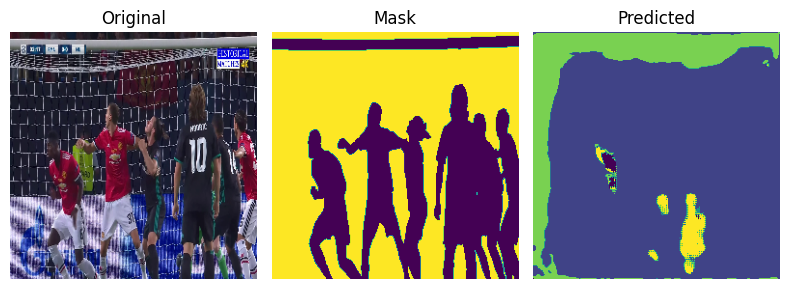

10/10 [==============================] - 4s 417ms/step - loss: 10448.7090 - accuracy: 0.3771
Epoch 38/100
1/1 [==============================] - 0s 23ms/step


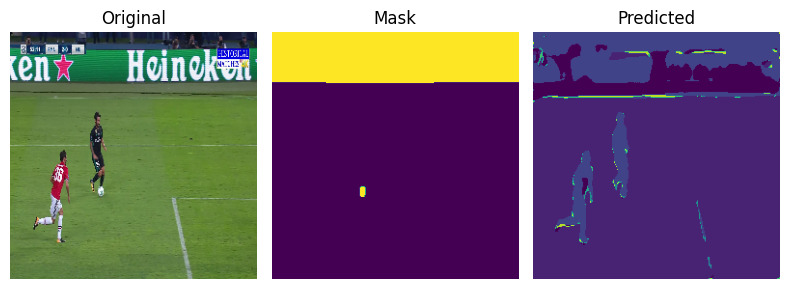

10/10 [==============================] - 4s 422ms/step - loss: 23409.5352 - accuracy: 0.4989
Epoch 39/100
1/1 [==============================] - 0s 21ms/step


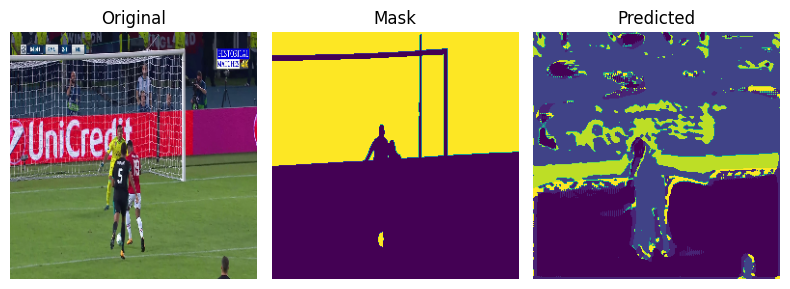

10/10 [==============================] - 4s 430ms/step - loss: 13791.8877 - accuracy: 0.3941
Epoch 40/100
1/1 [==============================] - 0s 20ms/step


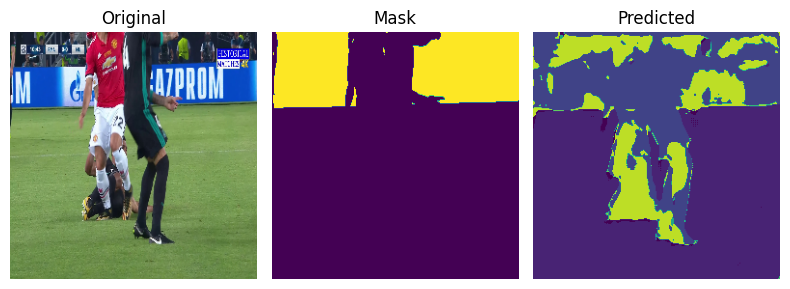

10/10 [==============================] - 4s 425ms/step - loss: 15567.0879 - accuracy: 0.4797
Epoch 41/100
1/1 [==============================] - 0s 23ms/step


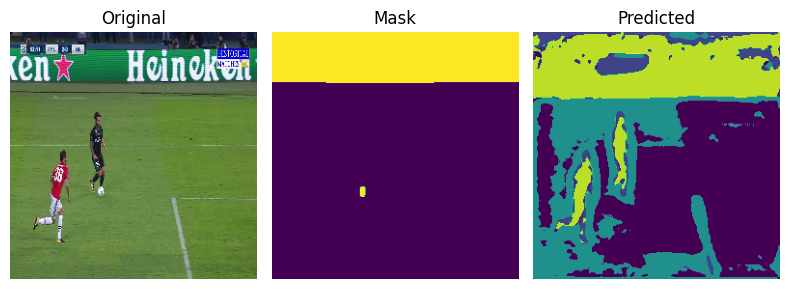

10/10 [==============================] - 4s 430ms/step - loss: 17136.9668 - accuracy: 0.4670
Epoch 42/100
1/1 [==============================] - 0s 21ms/step


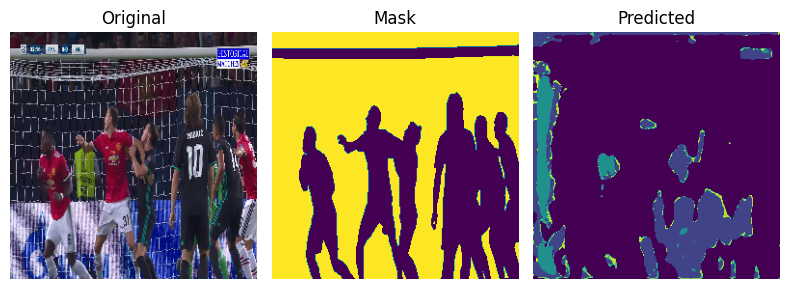

10/10 [==============================] - 4s 426ms/step - loss: 21999.2891 - accuracy: 0.4192
Epoch 43/100
1/1 [==============================] - 0s 23ms/step


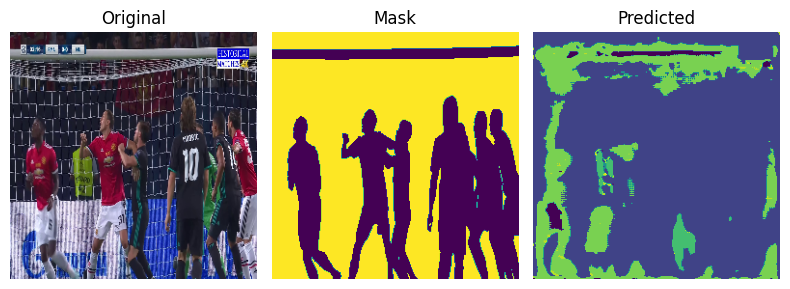

10/10 [==============================] - 4s 450ms/step - loss: 14195.5352 - accuracy: 0.4981
Epoch 44/100
1/1 [==============================] - 0s 22ms/step


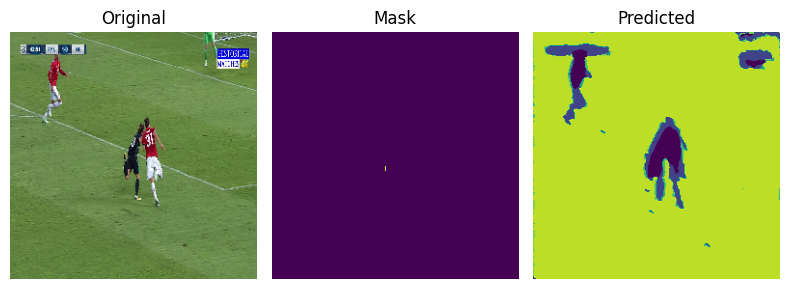

10/10 [==============================] - 4s 428ms/step - loss: 13133.5410 - accuracy: 0.5210
Epoch 45/100
1/1 [==============================] - 0s 23ms/step


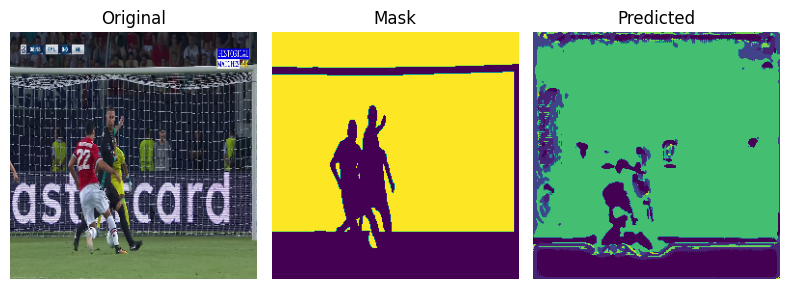

10/10 [==============================] - 4s 434ms/step - loss: 17740.5117 - accuracy: 0.4794
Epoch 46/100
1/1 [==============================] - 0s 22ms/step


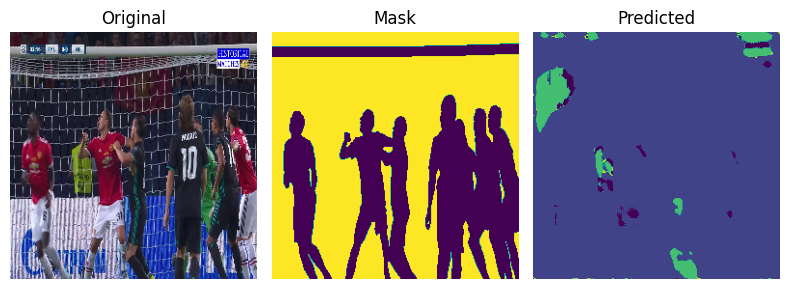

10/10 [==============================] - 4s 427ms/step - loss: 15192.0078 - accuracy: 0.4090
Epoch 47/100
1/1 [==============================] - 0s 21ms/step


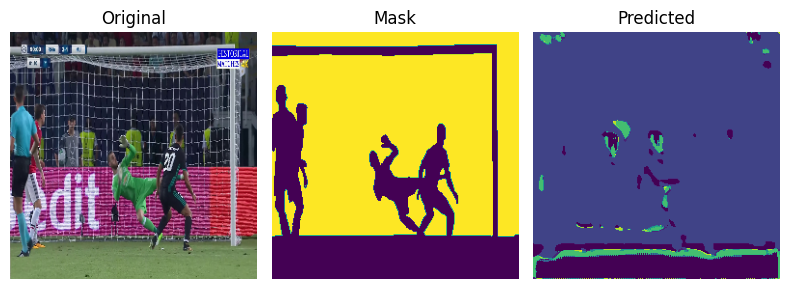

10/10 [==============================] - 4s 428ms/step - loss: 25895.7383 - accuracy: 0.3901
Epoch 48/100
1/1 [==============================] - 0s 21ms/step


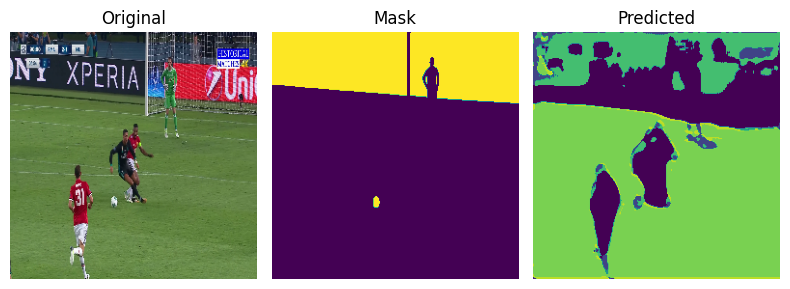

10/10 [==============================] - 4s 428ms/step - loss: 29209.1309 - accuracy: 0.4883
Epoch 49/100
1/1 [==============================] - 0s 22ms/step


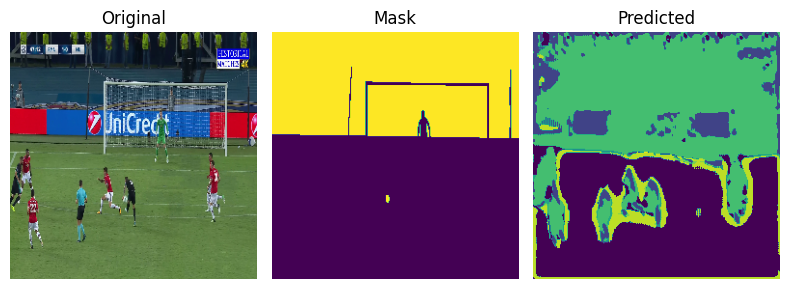

10/10 [==============================] - 4s 428ms/step - loss: 29827.0742 - accuracy: 0.4557
Epoch 50/100
1/1 [==============================] - 0s 21ms/step


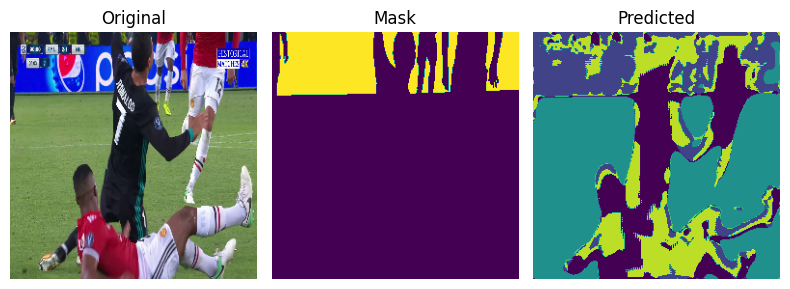

10/10 [==============================] - 4s 428ms/step - loss: 38030.1641 - accuracy: 0.3927
Epoch 51/100
1/1 [==============================] - 0s 20ms/step


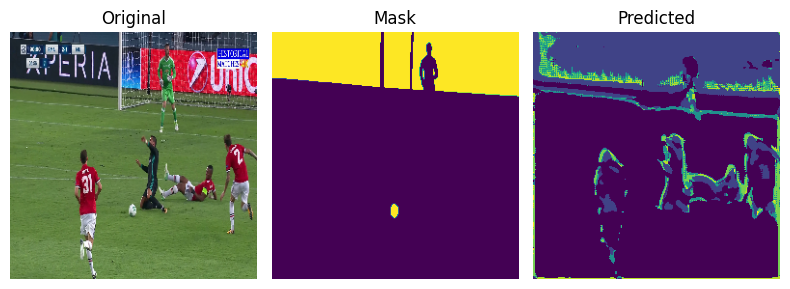

10/10 [==============================] - 4s 430ms/step - loss: 31490.5020 - accuracy: 0.4064
Epoch 52/100
1/1 [==============================] - 0s 21ms/step


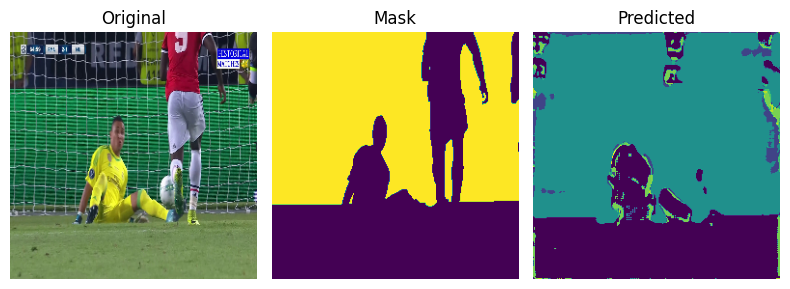

10/10 [==============================] - 4s 429ms/step - loss: 32653.5430 - accuracy: 0.4155
Epoch 53/100
1/1 [==============================] - 0s 21ms/step


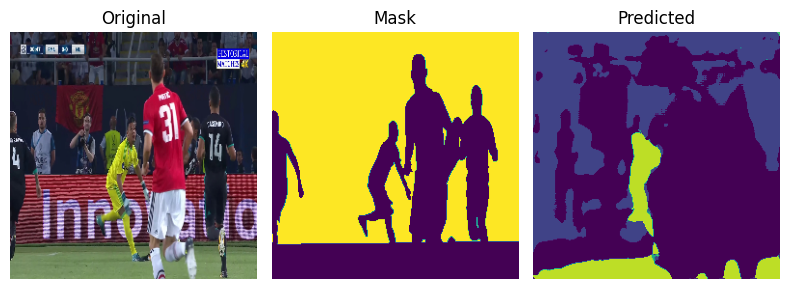

10/10 [==============================] - 4s 417ms/step - loss: 40199.4375 - accuracy: 0.3878
Epoch 54/100
1/1 [==============================] - 0s 21ms/step


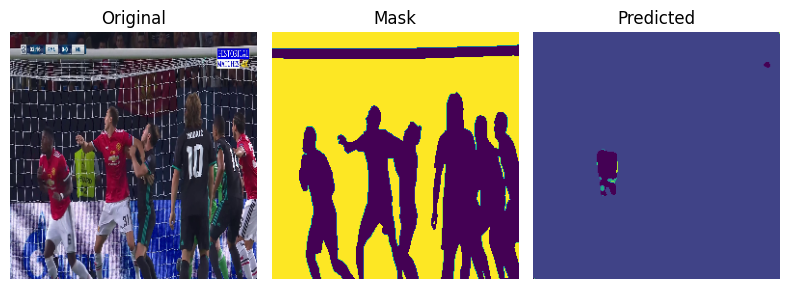

10/10 [==============================] - 4s 428ms/step - loss: 32973.3086 - accuracy: 0.5120
Epoch 55/100
1/1 [==============================] - 0s 21ms/step


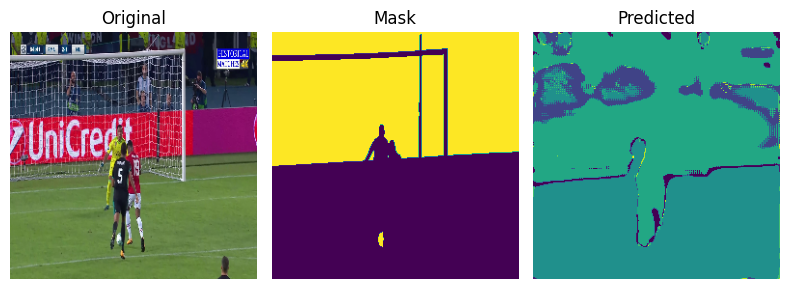

10/10 [==============================] - 4s 426ms/step - loss: 45302.9336 - accuracy: 0.5471
Epoch 56/100
1/1 [==============================] - 0s 21ms/step


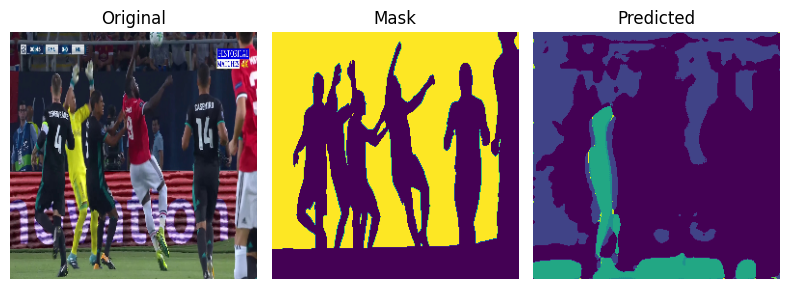

10/10 [==============================] - 4s 418ms/step - loss: 52436.8906 - accuracy: 0.3533
Epoch 57/100
1/1 [==============================] - 0s 20ms/step


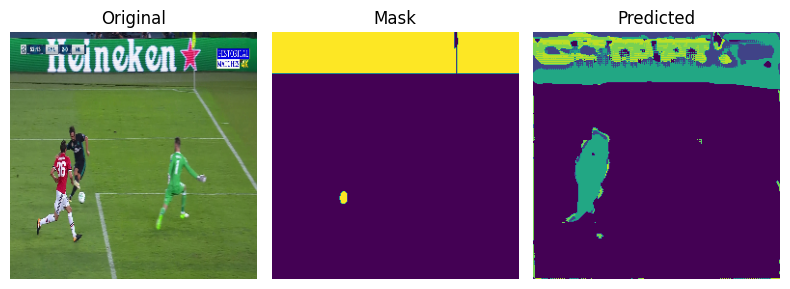

10/10 [==============================] - 4s 428ms/step - loss: 41176.9648 - accuracy: 0.4126
Epoch 58/100
1/1 [==============================] - 0s 21ms/step


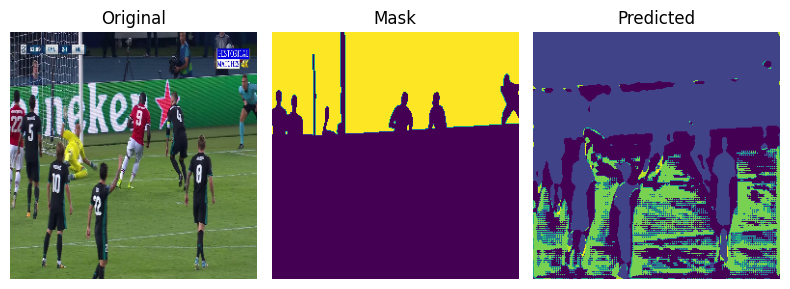

10/10 [==============================] - 4s 418ms/step - loss: 55365.3008 - accuracy: 0.4324
Epoch 59/100
1/1 [==============================] - 0s 23ms/step


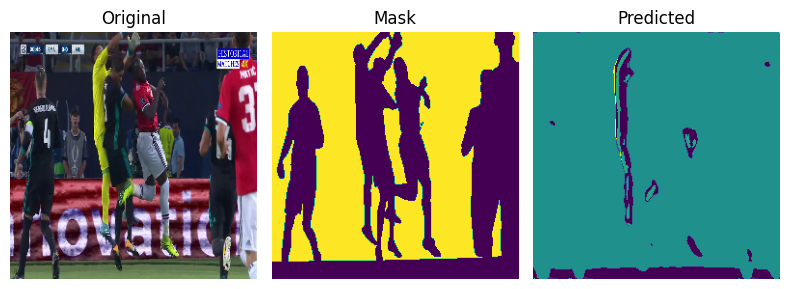

10/10 [==============================] - 4s 430ms/step - loss: 25360.1641 - accuracy: 0.5320
Epoch 60/100
1/1 [==============================] - 0s 22ms/step


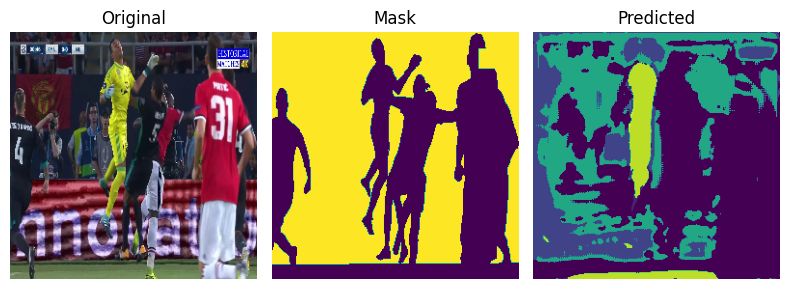

10/10 [==============================] - 5s 462ms/step - loss: 50583.3164 - accuracy: 0.4316
Epoch 61/100
1/1 [==============================] - 0s 23ms/step


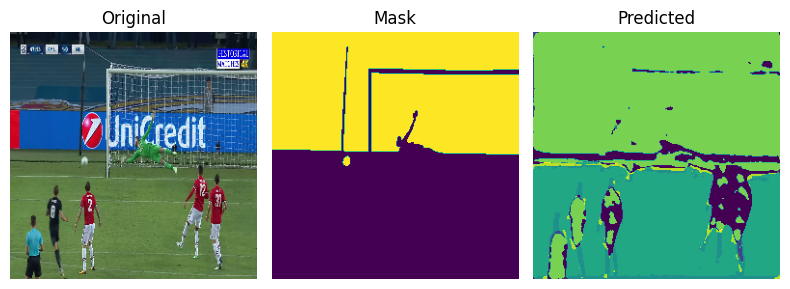

10/10 [==============================] - 4s 419ms/step - loss: 31907.5293 - accuracy: 0.5359
Epoch 62/100
1/1 [==============================] - 0s 21ms/step


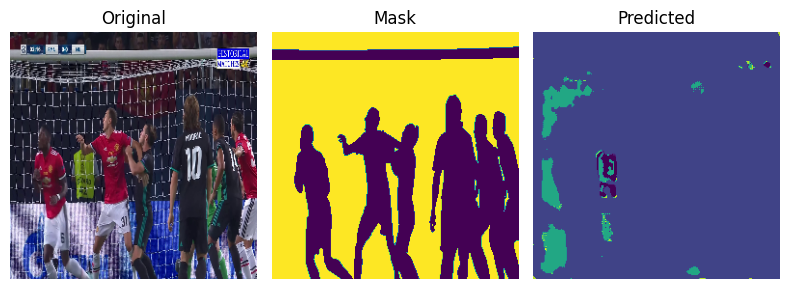

10/10 [==============================] - 4s 419ms/step - loss: 54962.8086 - accuracy: 0.4338
Epoch 63/100
1/1 [==============================] - 0s 21ms/step


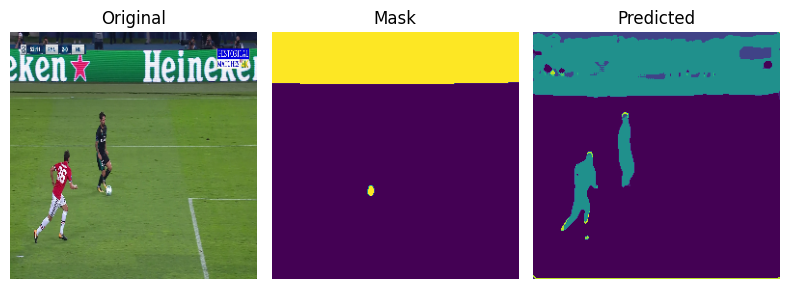

10/10 [==============================] - 4s 429ms/step - loss: 70854.7266 - accuracy: 0.3735
Epoch 64/100
1/1 [==============================] - 0s 24ms/step


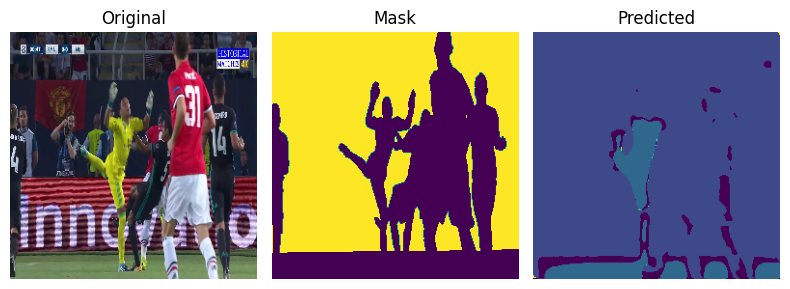

10/10 [==============================] - 4s 422ms/step - loss: 81813.6875 - accuracy: 0.4079
Epoch 65/100
1/1 [==============================] - 0s 22ms/step


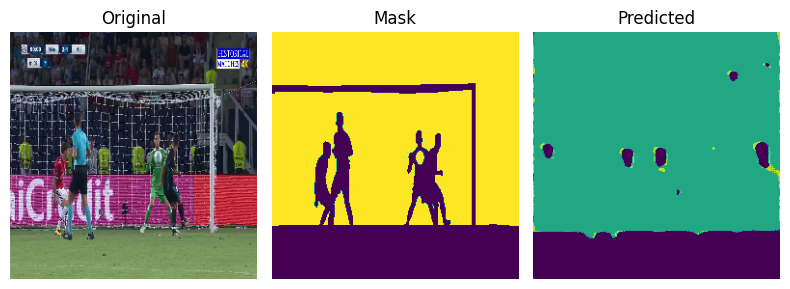

10/10 [==============================] - 4s 418ms/step - loss: 75318.2188 - accuracy: 0.5367
Epoch 66/100
1/1 [==============================] - 0s 22ms/step


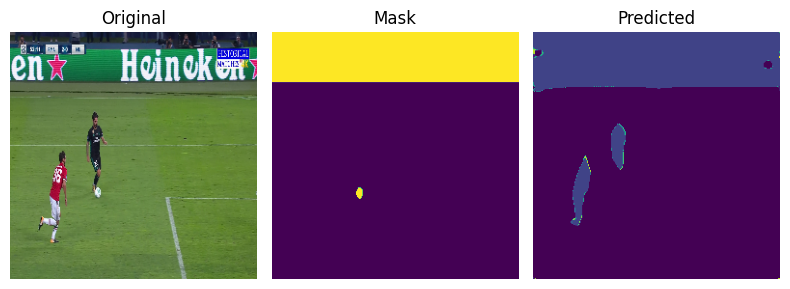

10/10 [==============================] - 4s 429ms/step - loss: 84482.9688 - accuracy: 0.4920
Epoch 67/100
1/1 [==============================] - 0s 21ms/step


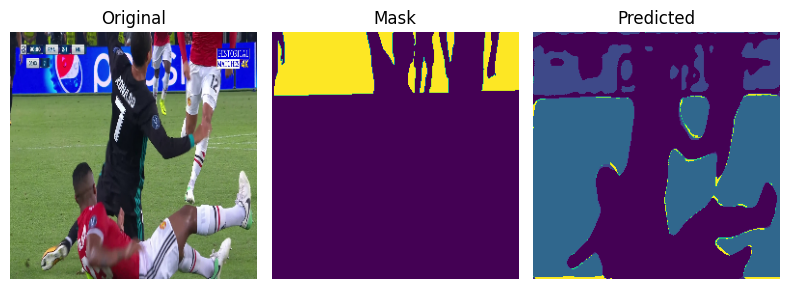

10/10 [==============================] - 4s 430ms/step - loss: 71913.2031 - accuracy: 0.4690
Epoch 68/100
1/1 [==============================] - 0s 22ms/step


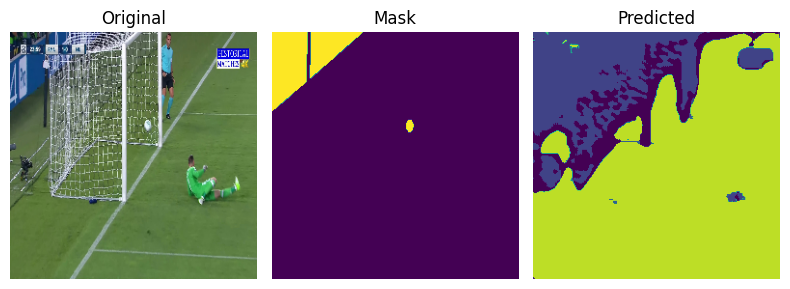

10/10 [==============================] - 4s 418ms/step - loss: 55864.7383 - accuracy: 0.5433
Epoch 69/100
1/1 [==============================] - 0s 21ms/step


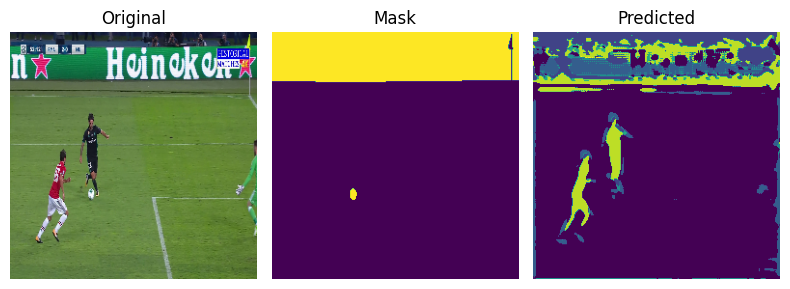

10/10 [==============================] - 4s 419ms/step - loss: 74236.8828 - accuracy: 0.5192
Epoch 70/100
1/1 [==============================] - 0s 21ms/step


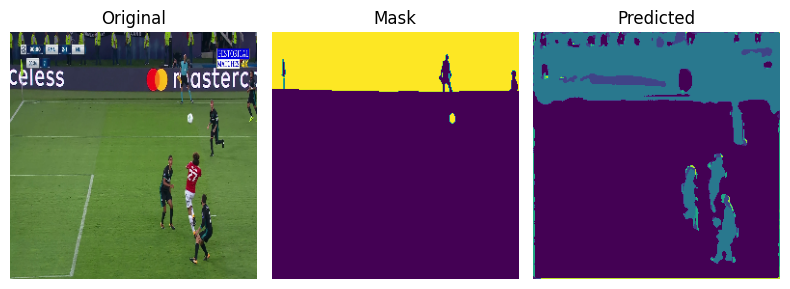

10/10 [==============================] - 4s 429ms/step - loss: 57340.5195 - accuracy: 0.5043
Epoch 71/100
1/1 [==============================] - 0s 22ms/step


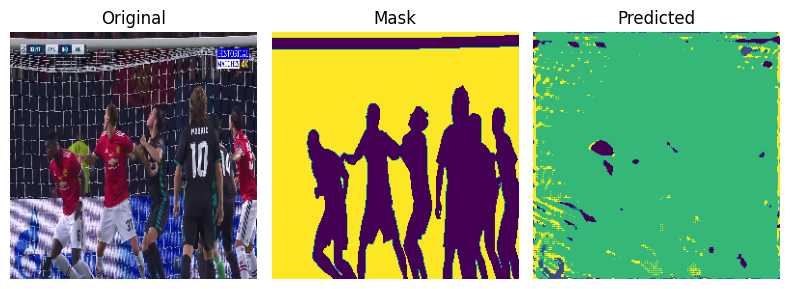

10/10 [==============================] - 4s 428ms/step - loss: 37252.9297 - accuracy: 0.4975
Epoch 72/100
1/1 [==============================] - 0s 21ms/step


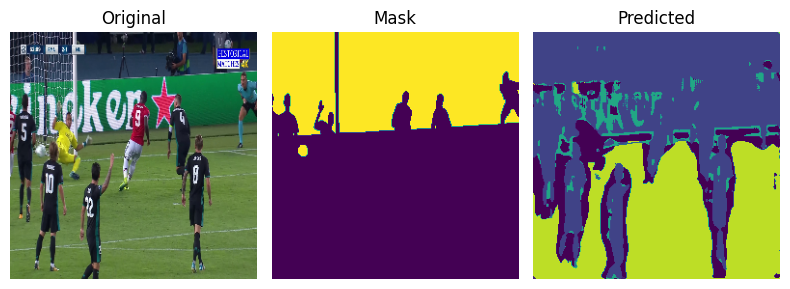

10/10 [==============================] - 4s 426ms/step - loss: 52077.9336 - accuracy: 0.4757
Epoch 73/100
1/1 [==============================] - 0s 20ms/step


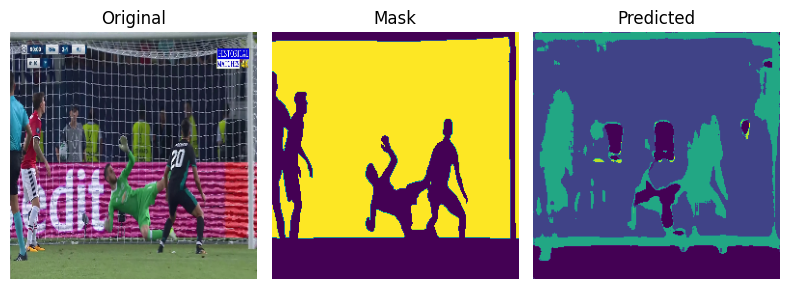

10/10 [==============================] - 4s 425ms/step - loss: 44916.6562 - accuracy: 0.5106
Epoch 74/100
1/1 [==============================] - 0s 20ms/step


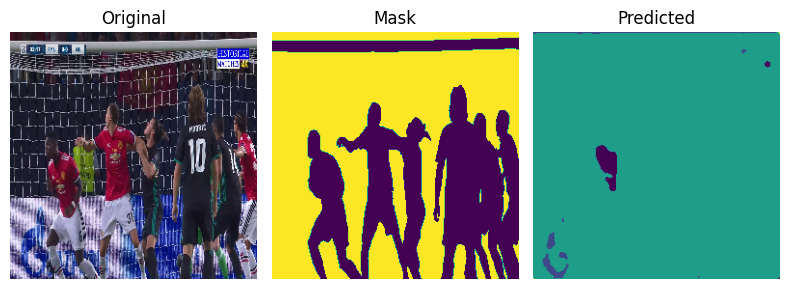

10/10 [==============================] - 4s 426ms/step - loss: 50322.7617 - accuracy: 0.5404
Epoch 75/100
1/1 [==============================] - 0s 21ms/step


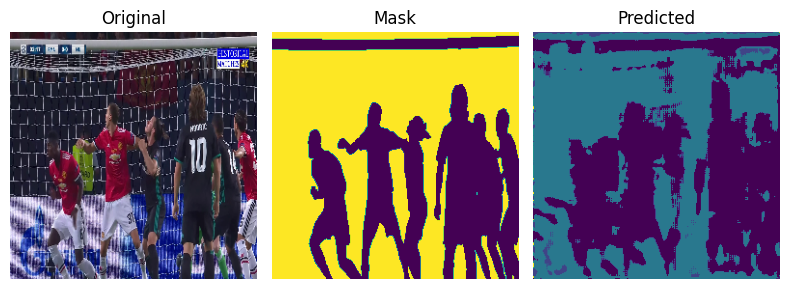

10/10 [==============================] - 4s 429ms/step - loss: 37854.2578 - accuracy: 0.5818
Epoch 76/100
1/1 [==============================] - 0s 21ms/step


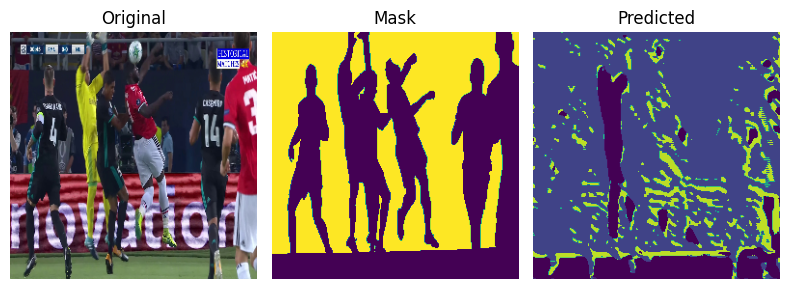

10/10 [==============================] - 4s 428ms/step - loss: 36338.3633 - accuracy: 0.6100
Epoch 77/100
1/1 [==============================] - 0s 21ms/step


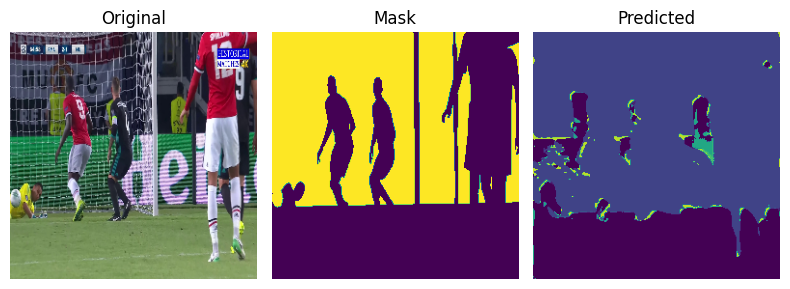

10/10 [==============================] - 4s 427ms/step - loss: 81037.6328 - accuracy: 0.4194
Epoch 78/100
1/1 [==============================] - 0s 23ms/step


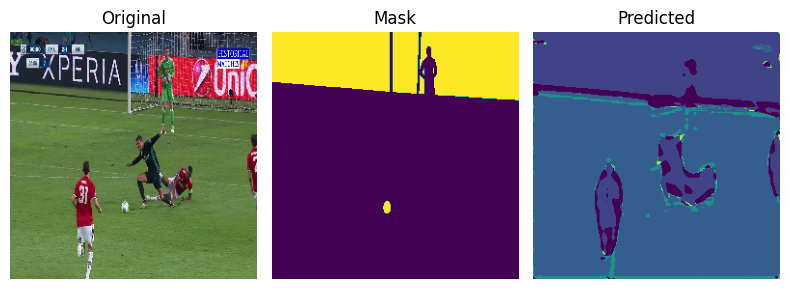

10/10 [==============================] - 5s 465ms/step - loss: 93392.8984 - accuracy: 0.5686
Epoch 79/100
1/1 [==============================] - 0s 22ms/step


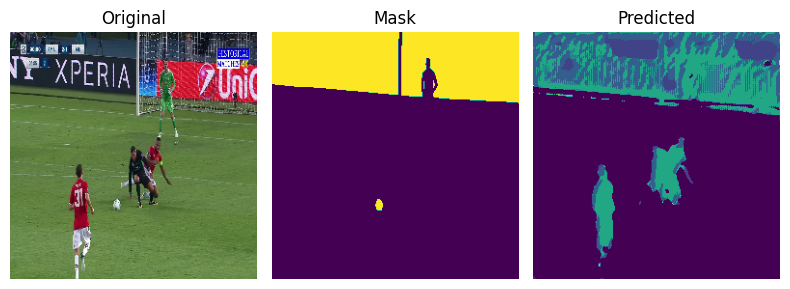

10/10 [==============================] - 4s 418ms/step - loss: 87072.0938 - accuracy: 0.6035
Epoch 80/100
1/1 [==============================] - 0s 21ms/step


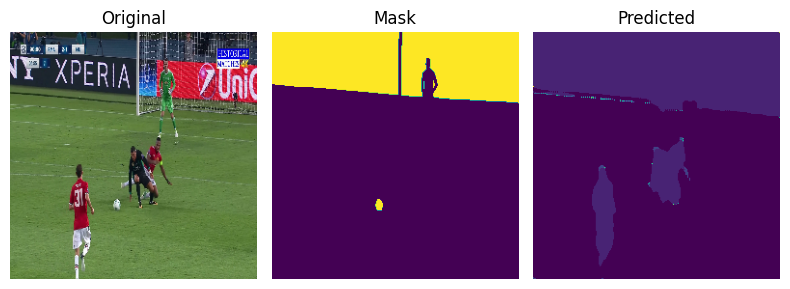

10/10 [==============================] - 4s 417ms/step - loss: 150902.4531 - accuracy: 0.3878
Epoch 81/100
1/1 [==============================] - 0s 21ms/step


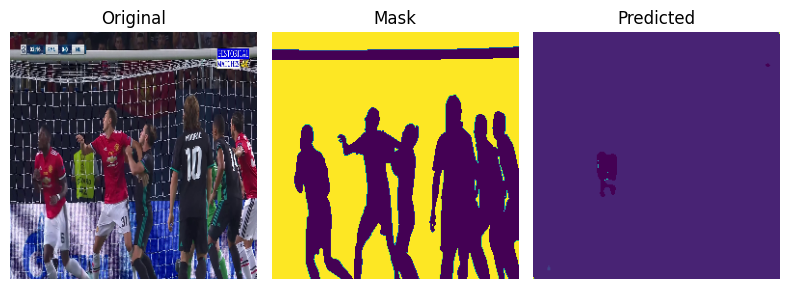

10/10 [==============================] - 4s 418ms/step - loss: 238334.7656 - accuracy: 0.4546
Epoch 82/100
1/1 [==============================] - 0s 21ms/step


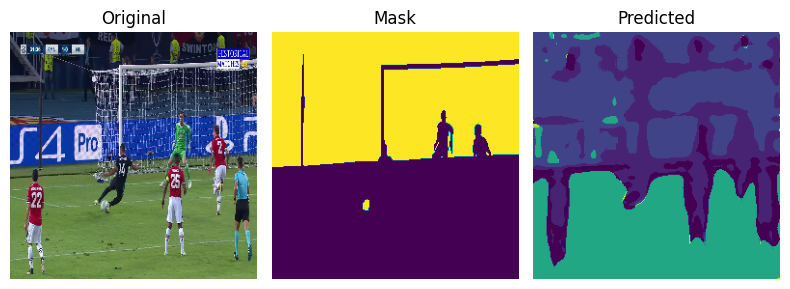

10/10 [==============================] - 4s 426ms/step - loss: 193776.3594 - accuracy: 0.4688
Epoch 83/100
1/1 [==============================] - 0s 22ms/step


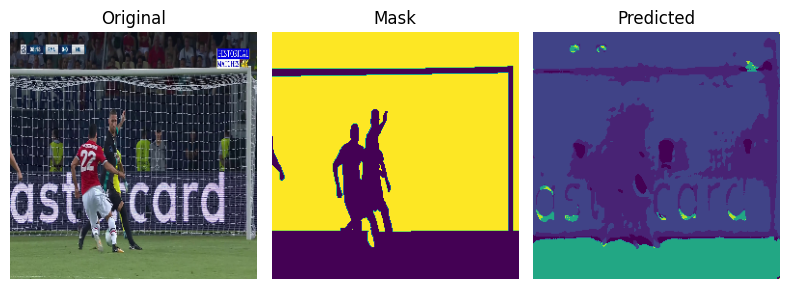

10/10 [==============================] - 4s 430ms/step - loss: 107089.8516 - accuracy: 0.4699
Epoch 84/100
1/1 [==============================] - 0s 23ms/step


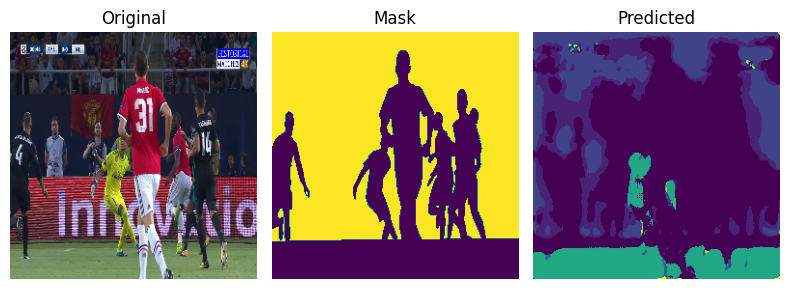

10/10 [==============================] - 4s 429ms/step - loss: 104443.2500 - accuracy: 0.6085
Epoch 85/100
1/1 [==============================] - 0s 21ms/step


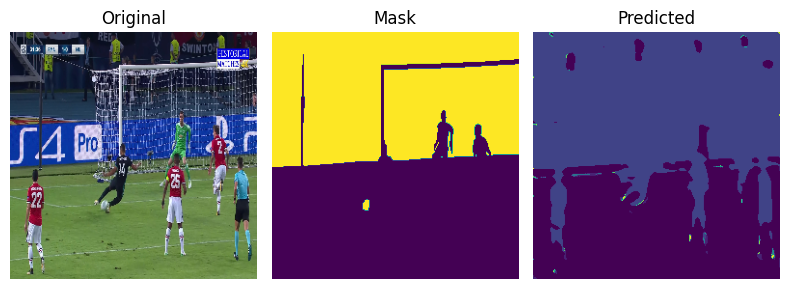

10/10 [==============================] - 4s 418ms/step - loss: 89097.2891 - accuracy: 0.6424
Epoch 86/100
1/1 [==============================] - 0s 20ms/step


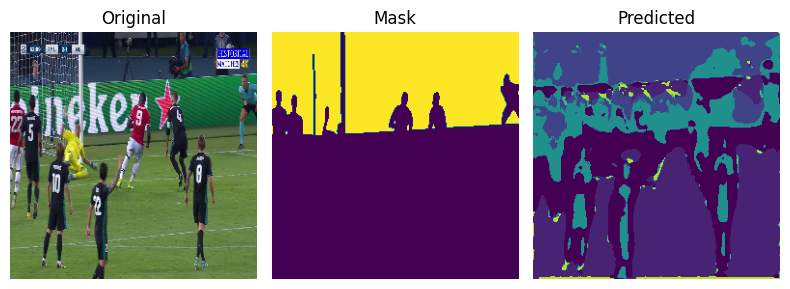

10/10 [==============================] - 4s 428ms/step - loss: 79624.2734 - accuracy: 0.5661
Epoch 87/100
1/1 [==============================] - 0s 21ms/step


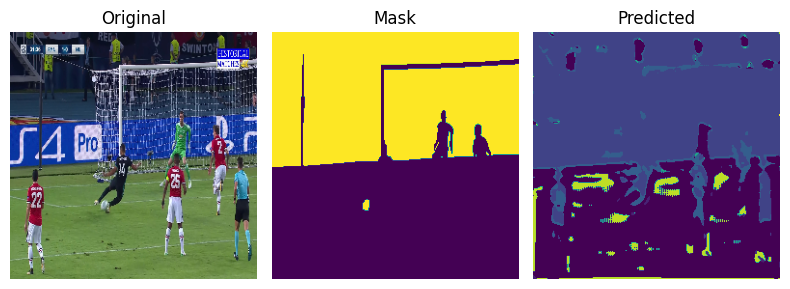

10/10 [==============================] - 4s 431ms/step - loss: 51446.8047 - accuracy: 0.5891
Epoch 88/100
1/1 [==============================] - 0s 21ms/step


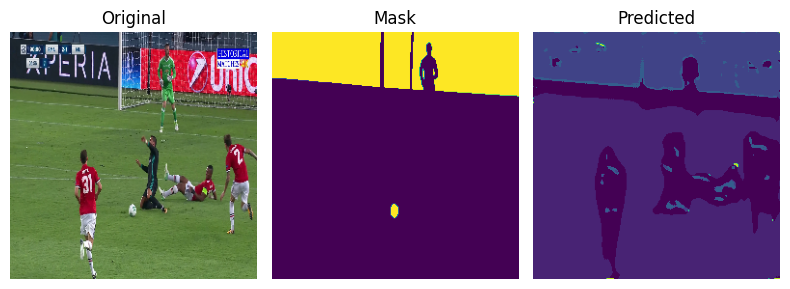

10/10 [==============================] - 4s 427ms/step - loss: 62634.7148 - accuracy: 0.5980
Epoch 89/100
1/1 [==============================] - 0s 23ms/step


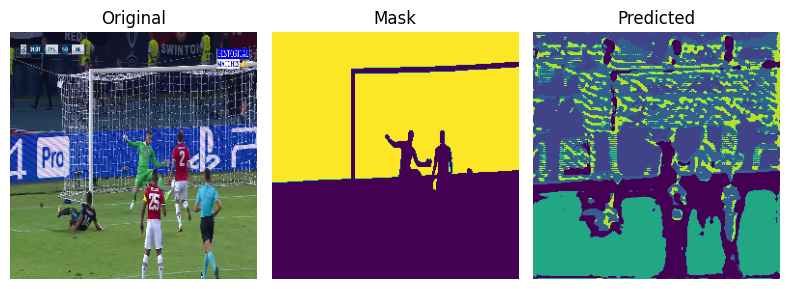

10/10 [==============================] - 4s 427ms/step - loss: 83687.6875 - accuracy: 0.5491
Epoch 90/100
1/1 [==============================] - 0s 20ms/step


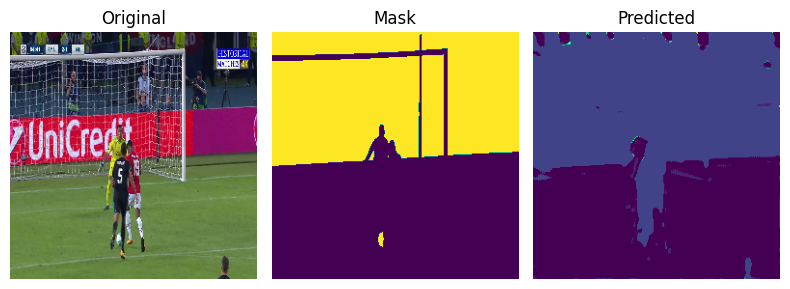

10/10 [==============================] - 4s 426ms/step - loss: 78007.7031 - accuracy: 0.5267
Epoch 91/100
1/1 [==============================] - 0s 21ms/step


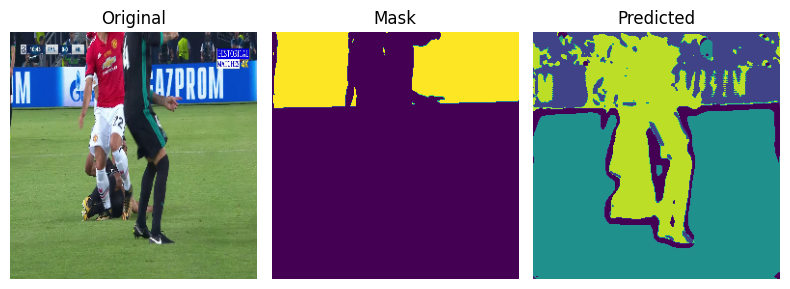

10/10 [==============================] - 4s 428ms/step - loss: 130606.7578 - accuracy: 0.5631
Epoch 92/100
1/1 [==============================] - 0s 22ms/step


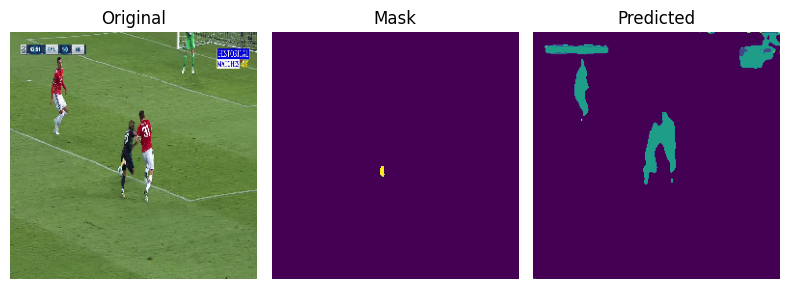

10/10 [==============================] - 4s 428ms/step - loss: 132526.2969 - accuracy: 0.5443
Epoch 93/100
1/1 [==============================] - 0s 23ms/step


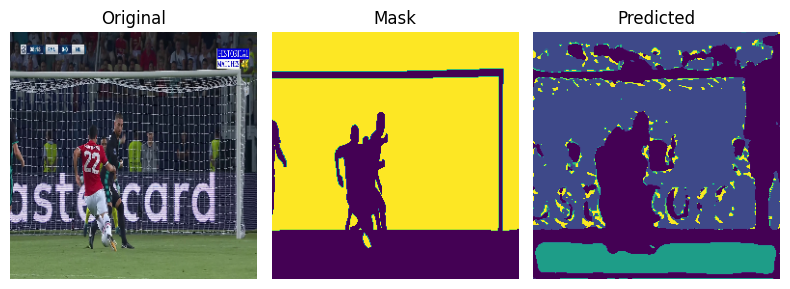

10/10 [==============================] - 4s 429ms/step - loss: 139140.7656 - accuracy: 0.5189
Epoch 94/100
1/1 [==============================] - 0s 20ms/step


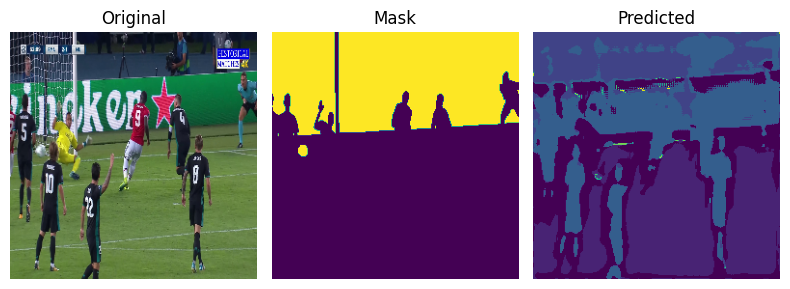

10/10 [==============================] - 4s 419ms/step - loss: 67424.6953 - accuracy: 0.6380
Epoch 95/100
1/1 [==============================] - 0s 21ms/step


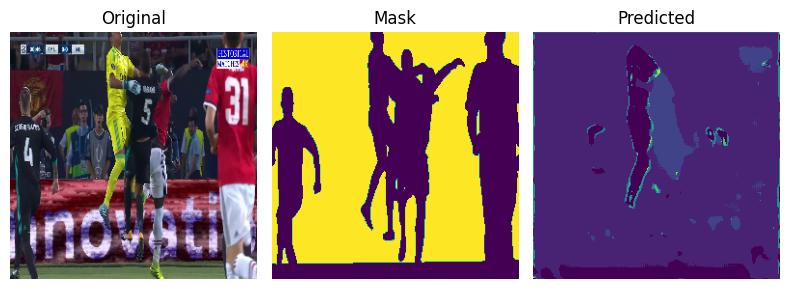

10/10 [==============================] - 4s 421ms/step - loss: 56677.0703 - accuracy: 0.6687
Epoch 96/100
1/1 [==============================] - 0s 24ms/step


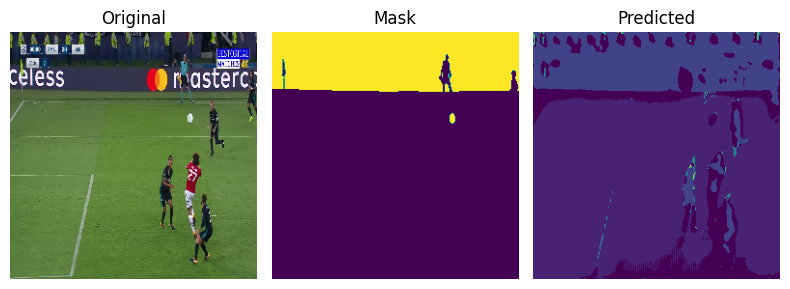

10/10 [==============================] - 5s 464ms/step - loss: 64903.5156 - accuracy: 0.6207
Epoch 97/100
1/1 [==============================] - 0s 23ms/step


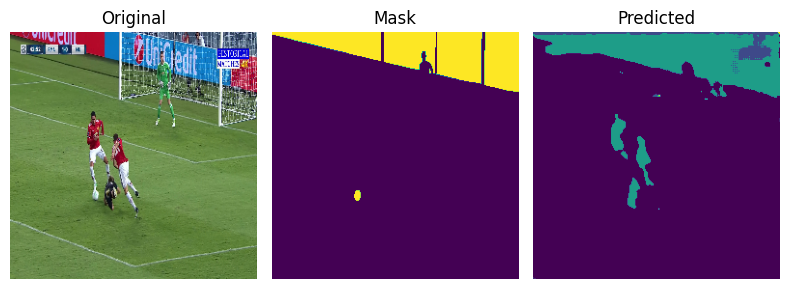

10/10 [==============================] - 4s 427ms/step - loss: 63837.3438 - accuracy: 0.6121
Epoch 98/100
1/1 [==============================] - 0s 21ms/step


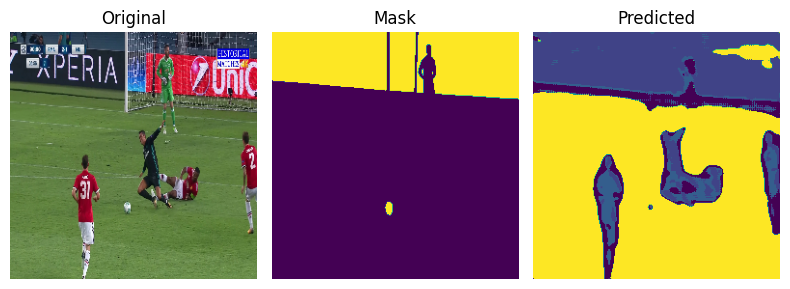

10/10 [==============================] - 4s 429ms/step - loss: 119547.6094 - accuracy: 0.5265
Epoch 99/100
1/1 [==============================] - 0s 21ms/step


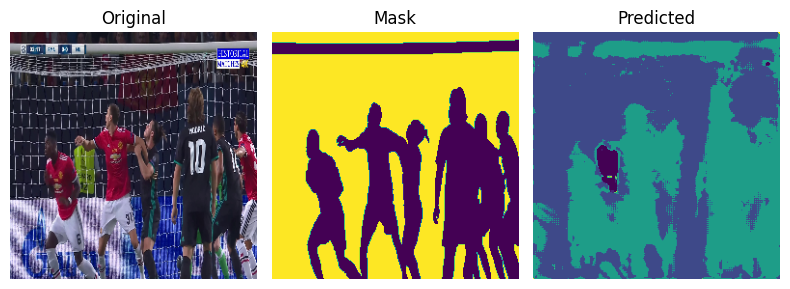

10/10 [==============================] - 4s 430ms/step - loss: 344879.5938 - accuracy: 0.4091
Epoch 100/100
1/1 [==============================] - 0s 22ms/step


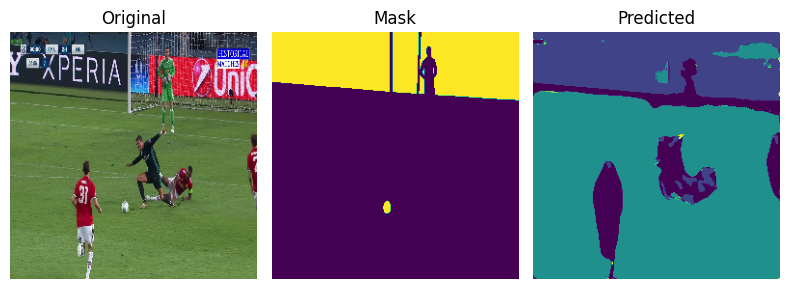

10/10 [==============================] - 4s 427ms/step - loss: 146362.2031 - accuracy: 0.5482


In [11]:
model.fit(
    images, masks_encoded,
    epochs=len(images),
    batch_size=10,
    callbacks=[callbacks.ModelCheckpoint("U-Net.h5", save_best_only=True), ShowProgress()]
)